In [ ]:
!pip install --upgrade transformers datasets

In [ ]:
!pip install matplotlib seaborn tqdm
!pip install --no-deps shap
!pip install multiprocess

In [ ]:
!pip install --upgrade sympy

In [ ]:
import os
import time
import re
import io
import numpy as np
import pandas as pd
import shap
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_recall_fscore_support
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from datasets import Dataset
import torch

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

import logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

Using device: cuda


In [ ]:
from google.colab import drive

In [ ]:

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:

logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

In [ ]:

def set_seed(seed=42):
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

set_seed()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading data from specified path: /content/drive/MyDrive/Thesis/FINALDATASET.csv
Successfully loaded data using separator ';', detected 26 columns

Successfully loaded dataset! Shape: (2412, 26)

First 5 rows of dataset:
  Affected_data_volume  Criminal_investigation_exception  Date  \
0           unspecific                                 0  2020   
1           unspecific                                 0  2020   
2           unspecific                                 0  2019   
3              1500000                                 0  2023   
4           unspecific                                 0  2019   

  company_industry      country  country_security_exception  \
0        Education  Netherlands                           0   
1    Public sector      Estonia                           0   
2        Marketing        Spain                           0   
3

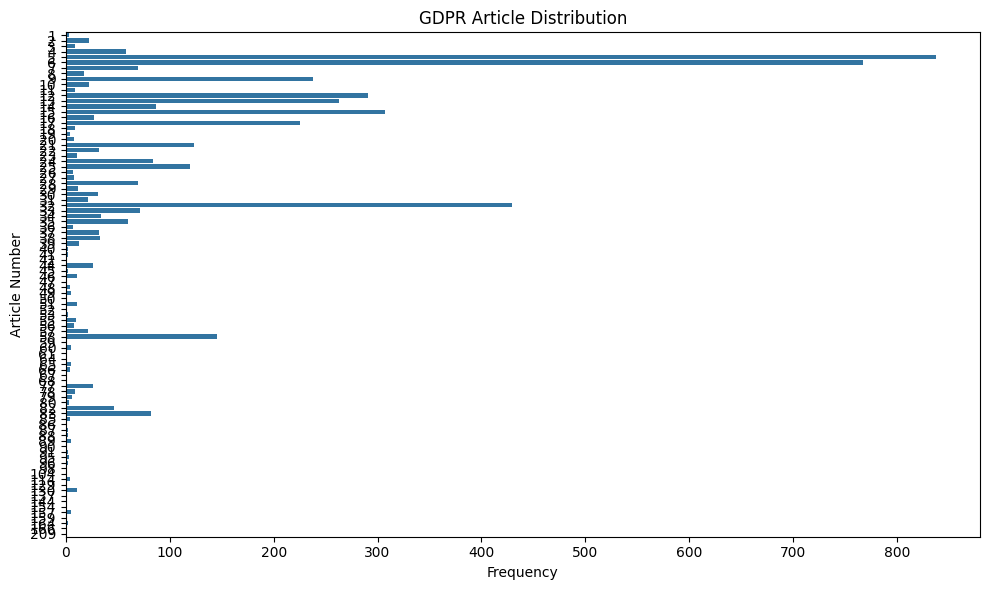


Data exploration completed.


In [ ]:
# Data Exploration Functions
def explore_gdpr_data(df, gdpr_column='gdpr_clause', target_column='legal_area'):
    """Explore characteristics of GDPR clause data"""
    print(f"\n===== GDPR Clause Data Exploration =====")
    print(f"Dataset size: {df.shape[0]} rows x {df.shape[1]} columns")

    # Check if GDPR column exists
    if gdpr_column not in df.columns:
        print(f"Error: Column '{gdpr_column}' not found")
        return

    # Basic analysis
    print(f"\n1. Basic statistics for {gdpr_column} column:")
    print(f"Number of missing values: {df[gdpr_column].isna().sum()}")
    print(f"Number of unique values: {df[gdpr_column].nunique()}")

    # Extract all unique GDPR clauses
    all_clauses = set()
    clause_pattern = re.compile(r'Article \d+\(\d+\)\([a-z]\)')

    # Handle multi-value cases
    for value in df[gdpr_column].dropna():
        if isinstance(value, str):
            # Split possible multiple clauses
            for clause in value.split(','):
                clause = clause.strip()
                if clause and clause_pattern.search(clause):
                    all_clauses.add(clause)

    print(f"\n2. Unique GDPR clauses found ({len(all_clauses)}):")
    for clause in sorted(all_clauses):
        print(f"  - {clause}")

    # Analyze multi-value cases
    if df[gdpr_column].dtype == 'object':
        multi_values = df[df[gdpr_column].str.contains(',', na=False)]
        print(f"\n3. Number of rows with multiple GDPR clauses: {len(multi_values)}")
        if len(multi_values) > 0:
            print("Multi-value examples:")
            for i, val in enumerate(multi_values[gdpr_column].head(3)):
                print(f"  {i+1}. {val}")

    # Extract main clauses (Article numbers)
    main_articles = []
    for value in df[gdpr_column].dropna():
        if isinstance(value, str):
            # Use regex to extract article numbers
            matches = re.findall(r'Article (\d+)', value)
            for match in matches:
                main_articles.append(int(match))

    # Plot clause distribution
    if main_articles:
        print("\n4. Generating GDPR clause distribution visualization...")
        plt.figure(figsize=(10, 6))
        sns.countplot(y=main_articles)
        plt.title('GDPR Article Distribution')
        plt.xlabel('Frequency')
        plt.ylabel('Article Number')
        plt.tight_layout()
        plt.show()

    # Target variable association analysis
    if target_column and target_column in df.columns:
        print(f"\n5. Association with target variable '{target_column}':")
        # Extract main clauses
        df['temp_main_article'] = df[gdpr_column].apply(
            lambda x: re.findall(r'Article (\d+)', str(x))[0] if isinstance(x, str) and re.findall(r'Article (\d+)', str(x)) else None
        )

        # Calculate target distribution for each clause
        article_target = df.groupby('temp_main_article')[target_column].value_counts(normalize=True).unstack()

        print("Target variable distribution for each main clause:")
        print(article_target)

        # Visualize relationship between target and clauses
        plt.figure(figsize=(12, 7))
        article_target.plot(kind='bar', stacked=True)
        plt.title(f'Relationship between GDPR clauses and {target_column}')
        plt.xlabel('Article Number')
        plt.ylabel('Proportion')
        plt.legend(title=target_column)
        plt.tight_layout()
        plt.show()

        # Delete temporary column
        df.drop('temp_main_article', axis=1, inplace=True)

    print("\nData exploration completed.")
    return

# Automatic data exploration main function
def auto_explore_data():
    # Mount Google Drive
    drive.mount('/content/drive')

    # Load data directly from specified path
    file_path = '/content/drive/MyDrive/Thesis/FINALDATASET.csv'
    print(f"Loading data from specified path: {file_path}")

    try:
        # Try different separators
        separators = [';', ',', '\t', '|']
        df = None

        for sep in separators:
            try:
                temp_df = pd.read_csv(file_path, sep=sep)
                # If successfully read and column count is greater than 1, save the result
                if temp_df.shape[1] > 1:
                    if df is None or temp_df.shape[1] > df.shape[1]:
                        df = temp_df
                        print(f"Successfully loaded data using separator '{sep}', detected {temp_df.shape[1]} columns")
                        # If successfully loaded multiple columns, don't try other separators
                        if temp_df.shape[1] > 2:
                            break
            except Exception as e:
                print(f"Failed to load using separator '{sep}': {str(e)}")

        if df is None or df.shape[1] <= 1:
            print("Cannot correctly load data, please check file format.")
            return None

        # Display basic data information
        print(f"\nSuccessfully loaded dataset! Shape: {df.shape}")
        print("\nFirst 5 rows of dataset:")
        print(df.head())
        print("\nDataset column names:")
        print(df.columns.tolist())
        print("\nDataset basic information:")
        print(df.info())
        print("\nDataset numeric column statistics:")
        print(df.describe())

        # Automatically determine target column and GDPR clause column
        target_column = 'legal_area'  # Directly specify target column

        # Automatically detect GDPR clause column
        gdpr_column = None
        for col in df.columns:
            if 'gdpr' in col.lower() or 'article' in col.lower() or 'clause' in col.lower():
                gdpr_column = col
                break

        if gdpr_column:
            print(f"\nAutomatically detected GDPR clause column: {gdpr_column}")

            # Rename to standard name for code processing
            if gdpr_column != 'gdpr_clause':
                df['gdpr_clause'] = df[gdpr_column]
                gdpr_column = 'gdpr_clause'

            # Data exploration
            explore_gdpr_data(df, gdpr_column, target_column)
        else:
            print("No GDPR clause column detected, cannot perform GDPR clause-specific analysis.")

        return df, target_column, gdpr_column

    except Exception as e:
        print(f"Error during data processing: {str(e)}")
        return None, None, None

# Execute automatic data exploration
if __name__ == "__main__":
    df, target_column, gdpr_column = auto_explore_data()

In [ ]:
!pip install evaluate

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.0/84.0 kB 7.4 MB/s eta 0:00:00


# violation result

Using device: cuda
Loading data from specified path: /content/drive/MyDrive/Thesis/FINALDATASET.csv
Successfully loaded data using separator ';', detected 26 columns

Successfully loaded dataset! Shape: (2412, 26)

First 5 rows of dataset:
  Affected_data_volume  Criminal_investigation_exception  Date  \
0           unspecific                                 0  2020   
1           unspecific                                 0  2020   
2           unspecific                                 0  2019   
3              1500000                                 0  2023   
4           unspecific                                 0  2019   

  company_industry      country  country_security_exception  \
0        Education  Netherlands                           0   
1    Public sector      Estonia                           0   
2        Marketing        Spain                           0   
3          Medical       France                           0   
4           Retail     Portugal                 

tokenizer_config.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/702k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/655 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at JQ1984/legalbert_gdpr_pretrained and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



1.3 Tokenizing feature text...


Map:   0%|          | 0/1929 [00:00<?, ? examples/s]

Map:   0%|          | 0/483 [00:00<?, ? examples/s]


1.4 Starting baseline model training... (epochs=3, batch_size=16, lr=3e-5)


Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.243873,0.939959,0.935998,0.938367,0.939959
2,No log,0.205448,0.939959,0.935998,0.938367,0.939959
3,No log,0.189130,0.939959,0.935998,0.938367,0.939959


***** train metrics *****
  epoch                    =        3.0
  total_flos               =   709026GF
  train_loss               =     0.2283
  train_runtime            = 0:04:30.18
  train_samples_per_second =     21.419
  train_steps_per_second   =      1.344

1.5 Evaluating baseline model performance...


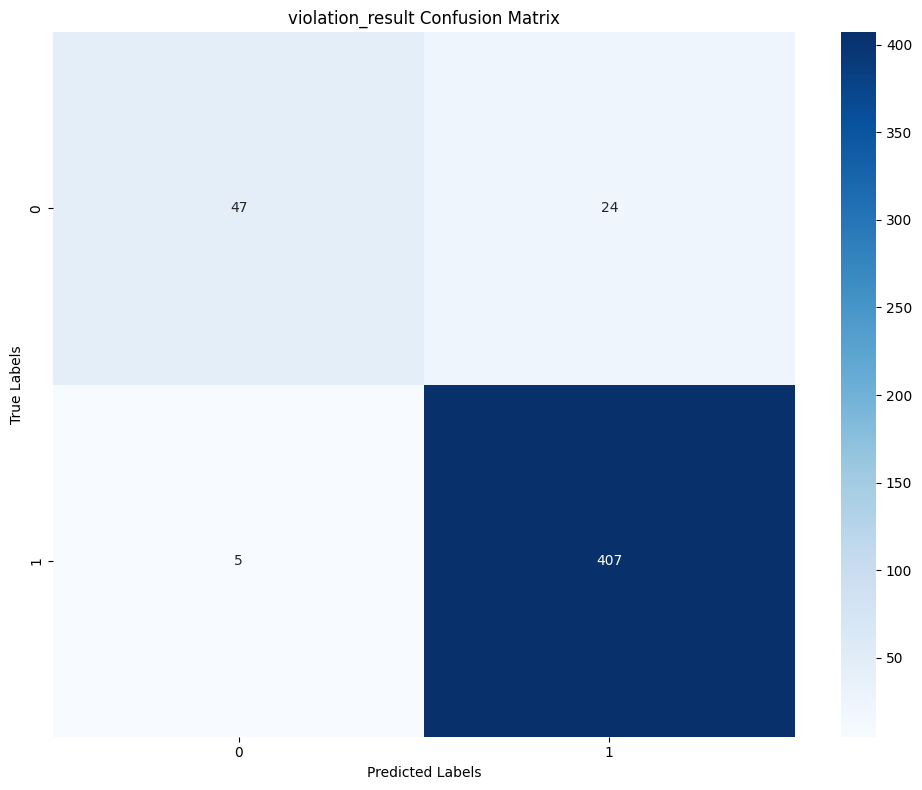


Classification Report:
              precision    recall  f1-score     support
0              0.903846  0.661972  0.764228   71.000000
1              0.944316  0.987864  0.965599  412.000000
accuracy       0.939959  0.939959  0.939959    0.939959
macro avg      0.924081  0.824918  0.864913  483.000000
weighted avg   0.938367  0.939959  0.935998  483.000000

1.6 Saving baseline model to Google Drive: /content/drive/MyDrive/Thesis/models/violation_result_legal_bert_baseline

===== Baseline Model Training Completed =====
Model accuracy: 0.9400
F1 score: 0.9360
Training time: 270.93 seconds

===== Step 2: Hyperparameter Tuning =====

2.1 Starting hyperparameter grid search...

2.2 Testing parameter combination 1/6: {'learning_rate': 2e-05, 'batch_size': 16, 'epochs': 3, 'weight_decay': 0.01}


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at JQ1984/legalbert_gdpr_pretrained and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/1929 [00:00<?, ? examples/s]

Map:   0%|          | 0/483 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.242576,0.939959,0.935998,0.938367,0.939959
2,No log,0.194202,0.939959,0.935998,0.938367,0.939959
3,No log,0.190419,0.939959,0.935998,0.938367,0.939959


***** train metrics *****
  epoch                    =        3.0
  total_flos               =   709026GF
  train_loss               =     0.2301
  train_runtime            = 0:04:34.44
  train_samples_per_second =     21.086
  train_steps_per_second   =      1.323


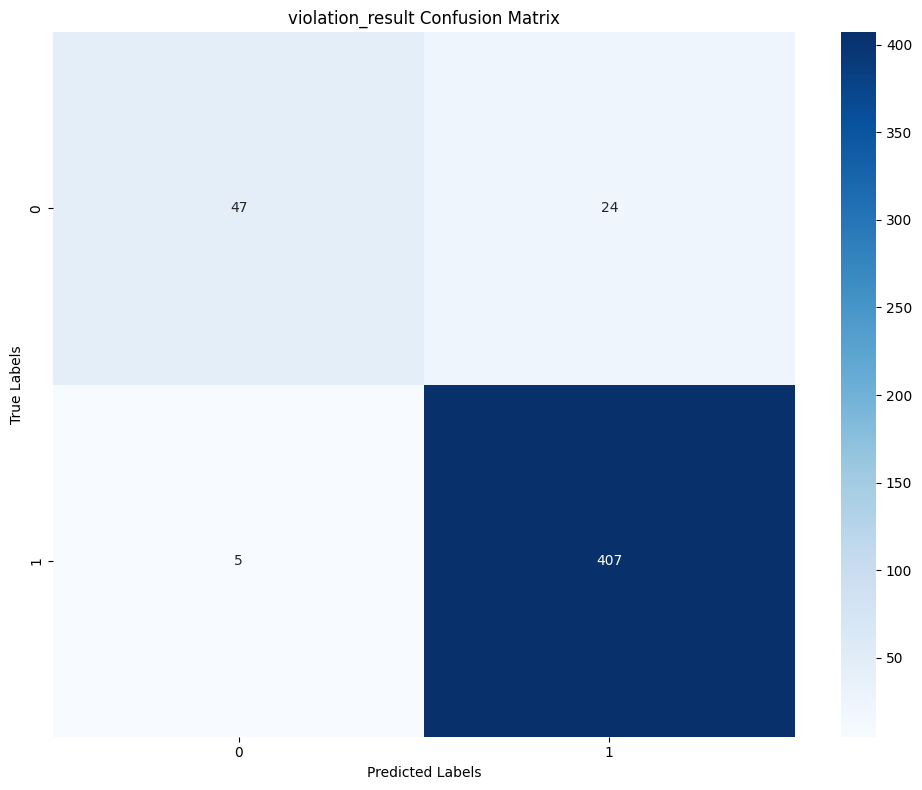


Classification Report:
              precision    recall  f1-score     support
0              0.903846  0.661972  0.764228   71.000000
1              0.944316  0.987864  0.965599  412.000000
accuracy       0.939959  0.939959  0.939959    0.939959
macro avg      0.924081  0.824918  0.864913  483.000000
weighted avg   0.938367  0.939959  0.935998  483.000000
Parameter combination 1 completed: Accuracy=0.9400, F1=0.9360, Training time=275.06s

2.2 Testing parameter combination 2/6: {'learning_rate': 5e-05, 'batch_size': 16, 'epochs': 3, 'weight_decay': 0.01}


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at JQ1984/legalbert_gdpr_pretrained and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/1929 [00:00<?, ? examples/s]

Map:   0%|          | 0/483 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.231631,0.937888,0.933533,0.936225,0.937888
2,No log,0.191826,0.937888,0.933533,0.936225,0.937888
3,No log,0.188126,0.937888,0.933533,0.936225,0.937888


***** train metrics *****
  epoch                    =        3.0
  total_flos               =   709026GF
  train_loss               =     0.2273
  train_runtime            = 0:04:37.66
  train_samples_per_second =     20.842
  train_steps_per_second   =      1.307


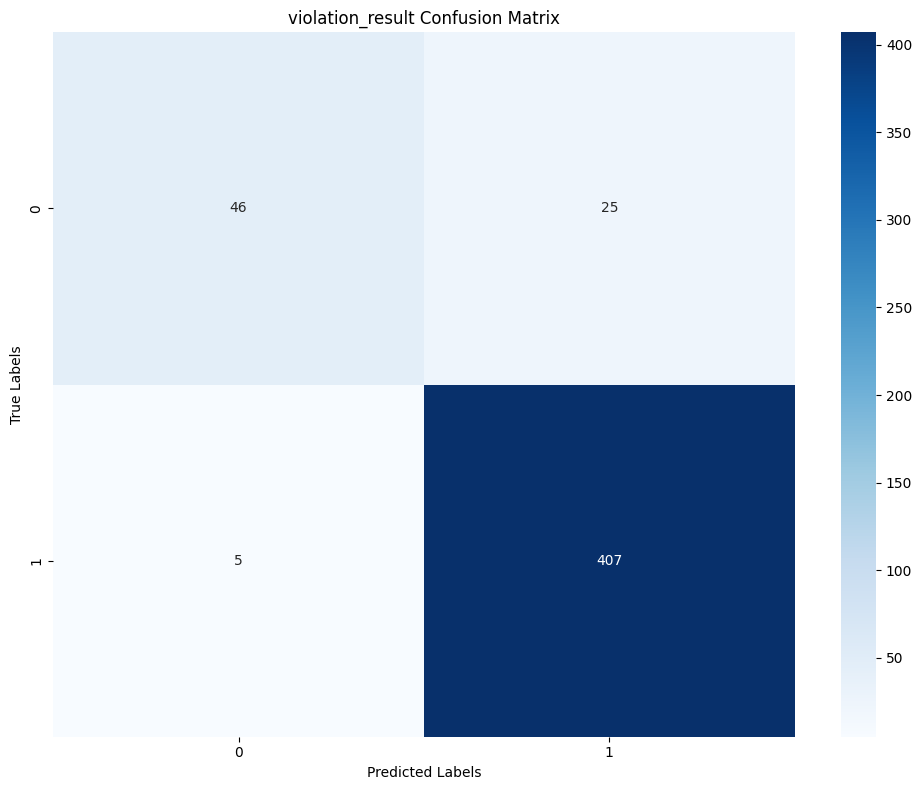


Classification Report:
              precision    recall  f1-score     support
0              0.901961  0.647887  0.754098   71.000000
1              0.942130  0.987864  0.964455  412.000000
accuracy       0.937888  0.937888  0.937888    0.937888
macro avg      0.922045  0.817876  0.859277  483.000000
weighted avg   0.936225  0.937888  0.933533  483.000000
Parameter combination 2 completed: Accuracy=0.9379, F1=0.9335, Training time=278.23s

2.2 Testing parameter combination 3/6: {'learning_rate': 3e-05, 'batch_size': 8, 'epochs': 3, 'weight_decay': 0.01}


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at JQ1984/legalbert_gdpr_pretrained and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/1929 [00:00<?, ? examples/s]

Map:   0%|          | 0/483 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.241558,0.939959,0.935998,0.938367,0.939959
2,No log,0.206893,0.939959,0.935998,0.938367,0.939959
3,0.259200,0.207703,0.939959,0.935998,0.938367,0.939959


***** train metrics *****
  epoch                    =        3.0
  total_flos               =   709026GF
  train_loss               =     0.2483
  train_runtime            = 0:05:01.26
  train_samples_per_second =     19.209
  train_steps_per_second   =       2.41


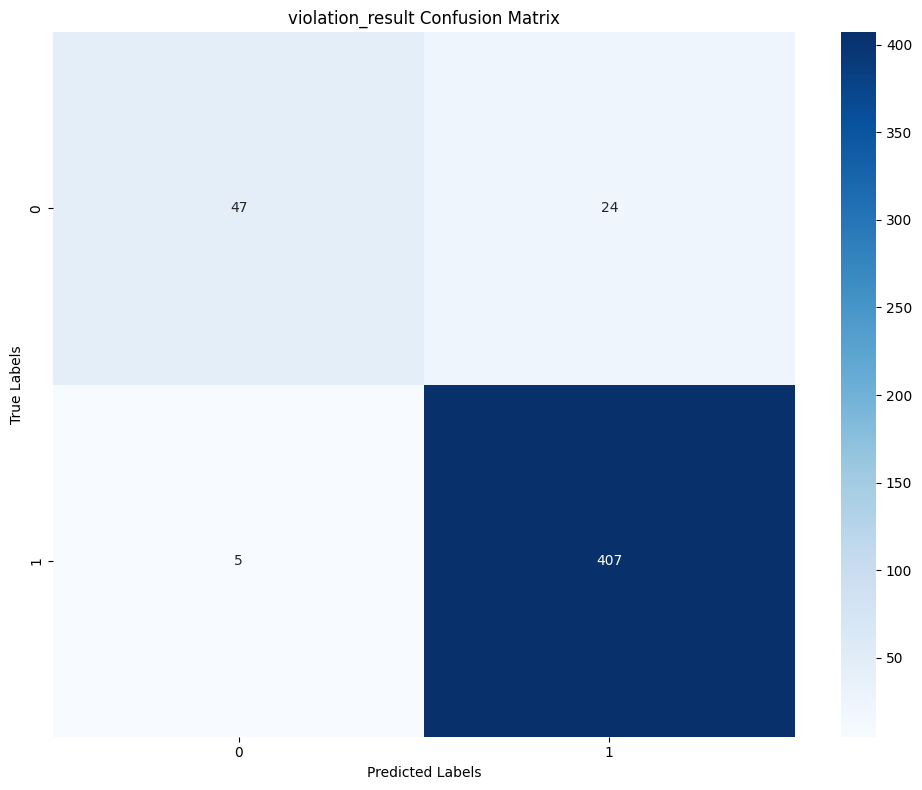


Classification Report:
              precision    recall  f1-score     support
0              0.903846  0.661972  0.764228   71.000000
1              0.944316  0.987864  0.965599  412.000000
accuracy       0.939959  0.939959  0.939959    0.939959
macro avg      0.924081  0.824918  0.864913  483.000000
weighted avg   0.938367  0.939959  0.935998  483.000000
Parameter combination 3 completed: Accuracy=0.9400, F1=0.9360, Training time=301.88s

2.2 Testing parameter combination 4/6: {'learning_rate': 3e-05, 'batch_size': 32, 'epochs': 3, 'weight_decay': 0.01}


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at JQ1984/legalbert_gdpr_pretrained and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/1929 [00:00<?, ? examples/s]

Map:   0%|          | 0/483 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.241812,0.939959,0.935998,0.938367,0.939959
2,No log,0.187611,0.939959,0.935998,0.938367,0.939959
3,No log,0.185318,0.939959,0.935998,0.938367,0.939959


***** train metrics *****
  epoch                    =        3.0
  total_flos               =   709026GF
  train_loss               =     0.2299
  train_runtime            = 0:04:32.34
  train_samples_per_second =     21.249
  train_steps_per_second   =      0.672


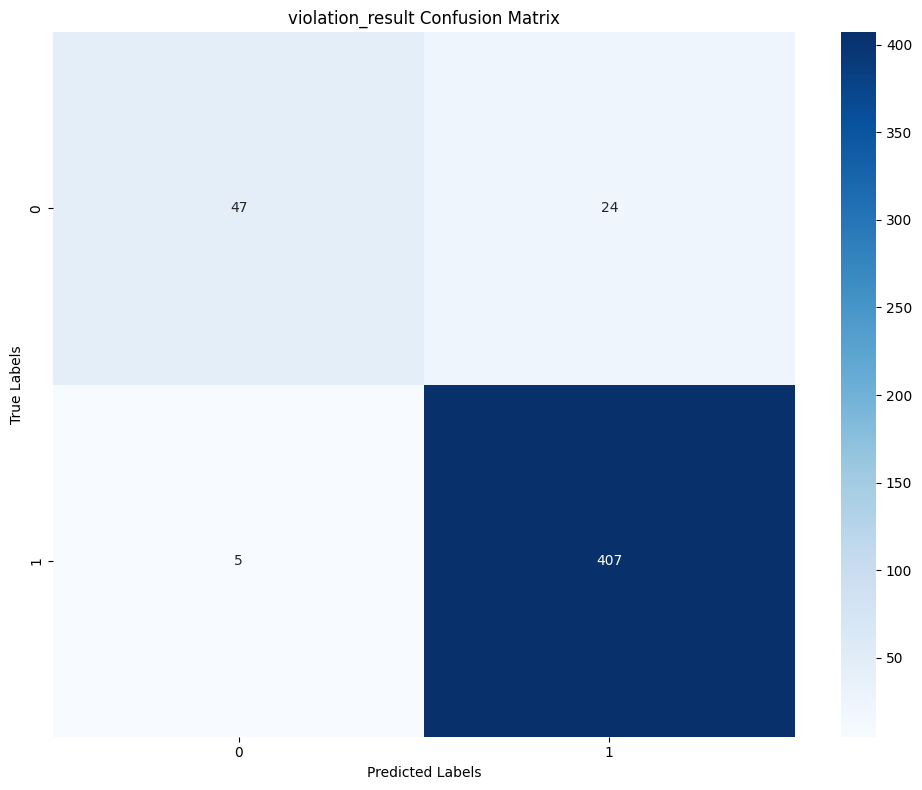


Classification Report:
              precision    recall  f1-score     support
0              0.903846  0.661972  0.764228   71.000000
1              0.944316  0.987864  0.965599  412.000000
accuracy       0.939959  0.939959  0.939959    0.939959
macro avg      0.924081  0.824918  0.864913  483.000000
weighted avg   0.938367  0.939959  0.935998  483.000000
Parameter combination 4 completed: Accuracy=0.9400, F1=0.9360, Training time=272.96s

2.2 Testing parameter combination 5/6: {'learning_rate': 3e-05, 'batch_size': 16, 'epochs': 5, 'weight_decay': 0.01}


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at JQ1984/legalbert_gdpr_pretrained and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/1929 [00:00<?, ? examples/s]

Map:   0%|          | 0/483 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.255273,0.939959,0.935998,0.938367,0.939959
2,No log,0.202488,0.939959,0.935998,0.938367,0.939959
3,No log,0.188872,0.939959,0.935998,0.938367,0.939959
4,No log,0.193168,0.939959,0.935998,0.938367,0.939959
5,0.230400,0.203286,0.939959,0.935998,0.938367,0.939959


***** train metrics *****
  epoch                    =        5.0
  total_flos               =  1181711GF
  train_loss               =      0.225
  train_runtime            = 0:07:43.38
  train_samples_per_second =     20.814
  train_steps_per_second   =      1.306


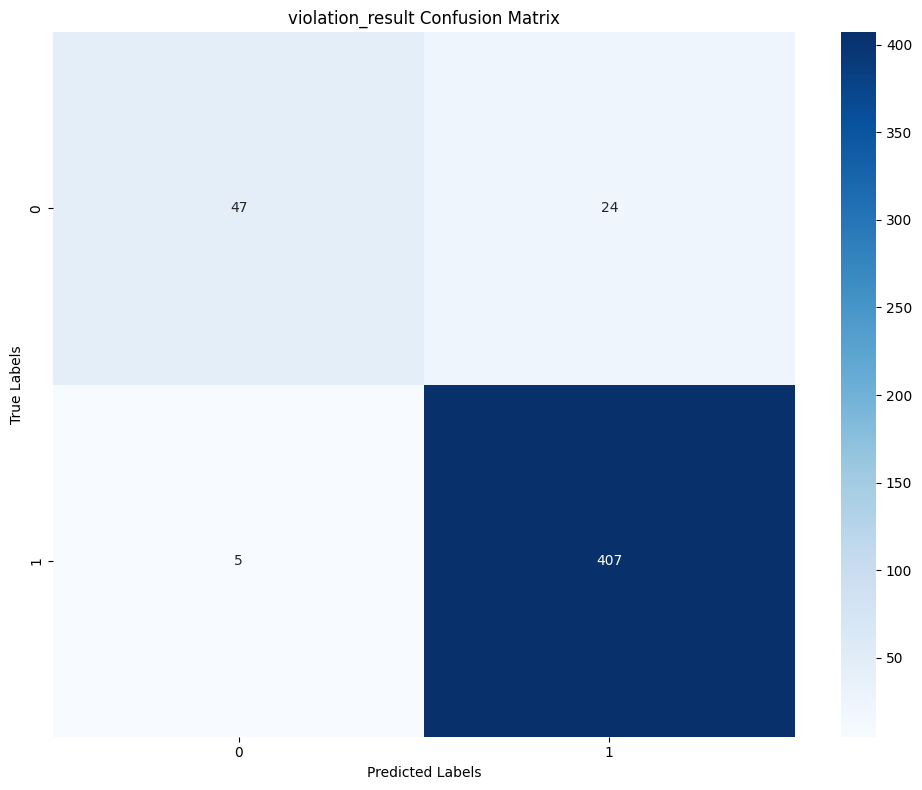


Classification Report:
              precision    recall  f1-score     support
0              0.903846  0.661972  0.764228   71.000000
1              0.944316  0.987864  0.965599  412.000000
accuracy       0.939959  0.939959  0.939959    0.939959
macro avg      0.924081  0.824918  0.864913  483.000000
weighted avg   0.938367  0.939959  0.935998  483.000000
Parameter combination 5 completed: Accuracy=0.9400, F1=0.9360, Training time=464.07s

2.2 Testing parameter combination 6/6: {'learning_rate': 3e-05, 'batch_size': 16, 'epochs': 3, 'weight_decay': 0.1}


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at JQ1984/legalbert_gdpr_pretrained and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/1929 [00:00<?, ? examples/s]

Map:   0%|          | 0/483 [00:00<?, ? examples/s]

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.257867,0.939959,0.935998,0.938367,0.939959
2,No log,0.201952,0.939959,0.935998,0.938367,0.939959
3,No log,0.194027,0.939959,0.935998,0.938367,0.939959


***** train metrics *****
  epoch                    =        3.0
  total_flos               =   709026GF
  train_loss               =     0.2316
  train_runtime            = 0:04:37.77
  train_samples_per_second =     20.833
  train_steps_per_second   =      1.307


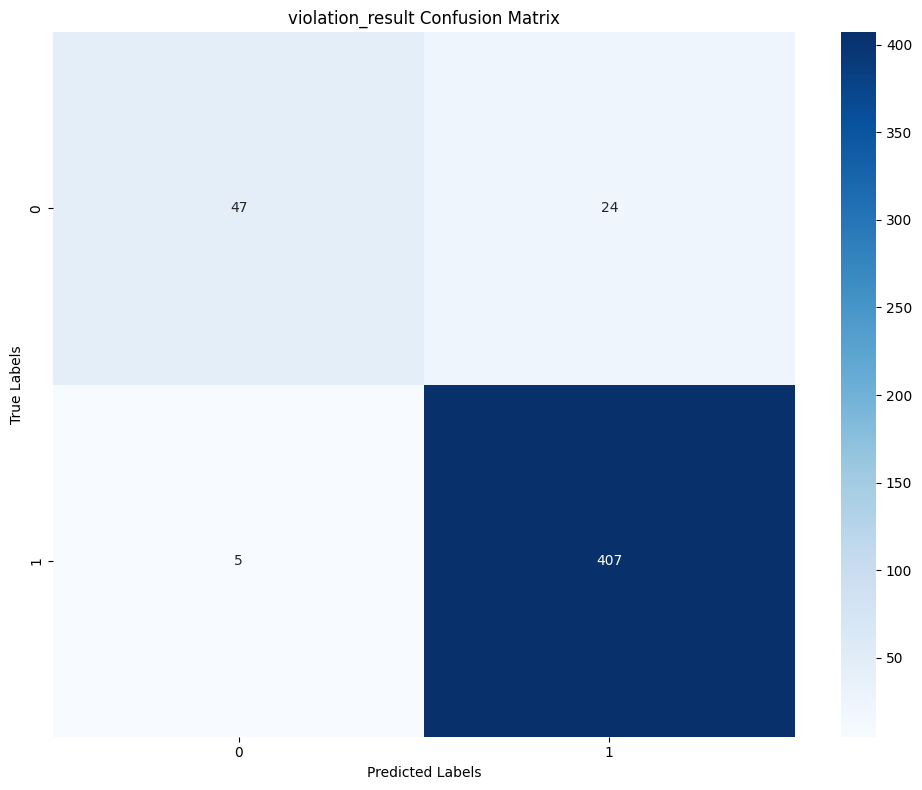


Classification Report:
              precision    recall  f1-score     support
0              0.903846  0.661972  0.764228   71.000000
1              0.944316  0.987864  0.965599  412.000000
accuracy       0.939959  0.939959  0.939959    0.939959
macro avg      0.924081  0.824918  0.864913  483.000000
weighted avg   0.938367  0.939959  0.935998  483.000000
Parameter combination 6 completed: Accuracy=0.9400, F1=0.9360, Training time=278.40s

2.3 Hyperparameter tuning completed, time taken: 2104.19s
Best parameters: {'learning_rate': 2e-05, 'batch_size': 16, 'epochs': 3, 'weight_decay': 0.01}
Best accuracy: 0.9400
Best model saved to: /content/drive/MyDrive/Thesis/models/violation_result_legal_bert_tuned

===== Step 3: Training Final Model =====

3.1 Training final model with best parameters: lr=2e-05, bs=16, epochs=3, weight_decay=0.01

3.2 Preparing training and testing data...

3.3 Loading Legal BERT model...


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at JQ1984/legalbert_gdpr_pretrained and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



3.4 Tokenizing feature text...


Map:   0%|          | 0/1929 [00:00<?, ? examples/s]

Map:   0%|          | 0/483 [00:00<?, ? examples/s]


3.5 Starting final model training...


Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,No log,0.242576,0.939959,0.935998,0.938367,0.939959
2,No log,0.194202,0.939959,0.935998,0.938367,0.939959
3,No log,0.190419,0.939959,0.935998,0.938367,0.939959


***** train metrics *****
  epoch                    =        3.0
  total_flos               =   709026GF
  train_loss               =     0.2301
  train_runtime            = 0:04:37.27
  train_samples_per_second =     20.871
  train_steps_per_second   =      1.309

3.6 Evaluating final model performance...


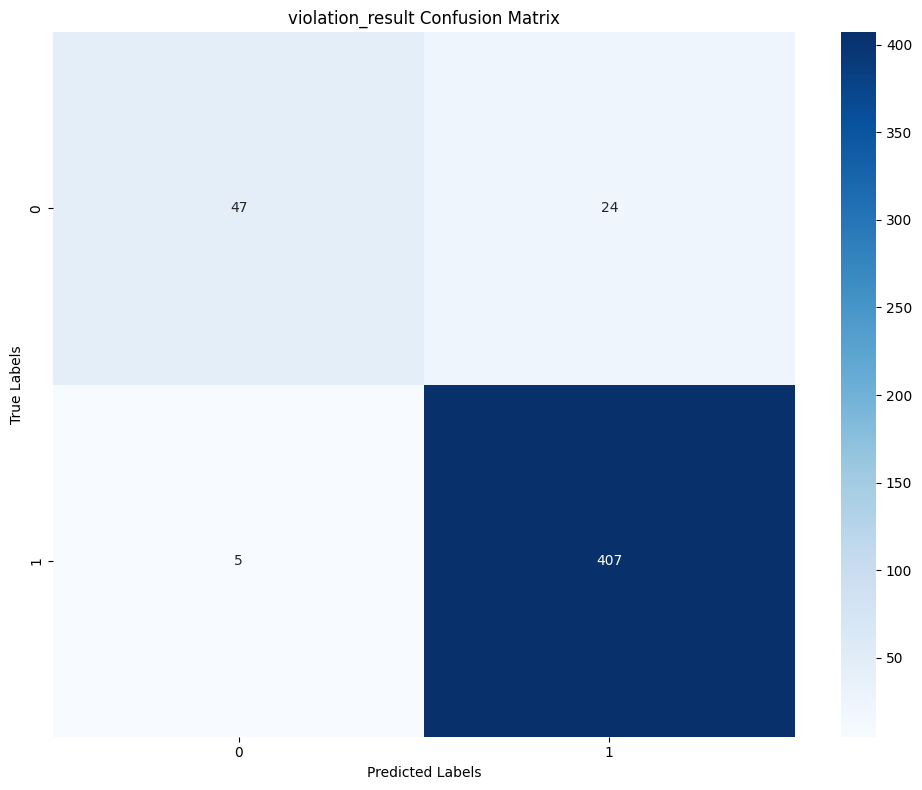


Classification Report:
              precision    recall  f1-score     support
0              0.903846  0.661972  0.764228   71.000000
1              0.944316  0.987864  0.965599  412.000000
accuracy       0.939959  0.939959  0.939959    0.939959
macro avg      0.924081  0.824918  0.864913  483.000000
weighted avg   0.938367  0.939959  0.935998  483.000000

3.7 Saving final model to Google Drive: /content/drive/MyDrive/Thesis/models/violation_result_legal_bert_final

===== Final Model Training Completed =====
Model accuracy: 0.9400
F1 score: 0.9360
Training time: 277.95 seconds
All results and charts saved to: /content/drive/MyDrive/Thesis/models/violation_result_legal_bert_final

===== Complete Model Training Process Ended =====
Baseline model accuracy: 0.9400
Final model accuracy: 0.9400
Performance improvement: 0.00%


In [ ]:
import seaborn as sns
import re
import time
import json
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_recall_fscore_support
from sklearn.preprocessing import LabelEncoder
import logging
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification, TrainingArguments, Trainer
from datasets import Dataset
import warnings
warnings.filterwarnings('ignore')

# Set up logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(name)s - %(levelname)s - %(message)s')
logger = logging.getLogger('TransformerClassifier')

# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load data directly from specified path
file_path = '/content/drive/MyDrive/Thesis/FINALDATASET.csv'
print(f"Loading data from specified path: {file_path}")

# Try different separators to load data
separators = [';', ',', '\t', '|']
df = None

for sep in separators:
    try:
        temp_df = pd.read_csv(file_path, sep=sep)
        if temp_df.shape[1] > 1:
            if df is None or temp_df.shape[1] > df.shape[1]:
                df = temp_df
                print(f"Successfully loaded data using separator '{sep}', detected {temp_df.shape[1]} columns")
                if temp_df.shape[1] > 20:  # If enough columns, consider the loading successful
                    break
    except Exception as e:
        print(f"Failed to load using separator '{sep}': {str(e)}")

if df is None or df.shape[1] <= 1:
    print("Cannot correctly load data, please check file format.")
else:
    # Display basic data information
    print(f"\nSuccessfully loaded dataset! Shape: {df.shape}")
    print("\nFirst 5 rows of dataset:")
    print(df.head())
    print("\nDataset information:")
    df.info()

# Set target variable
target_column = 'violation_result'
print(f"\nSet target variable: {target_column}")
print(f"Target variable value distribution:\n{df[target_column].value_counts()}")

# Install necessary libraries (if not already installed)
try:
    import transformers
    import datasets
except ImportError:
    print("Installing necessary libraries...")
    !pip install -q transformers datasets
    import transformers
    import datasets

class TransformerClassifier:
    def __init__(self, model_name="JQ1984/legalbert_gdpr_pretrained", num_labels=None, output_dir="./results"):
        self.model_name = model_name
        self.num_labels = num_labels
        self.output_dir = output_dir
        self.tokenizer = None
        self.model = None
        self.trainer = None
        self.train_time = None

        # Ensure output directory exists
        if not os.path.exists(output_dir):
            os.makedirs(output_dir)

    def _features_to_text(self, df):
        """Convert features to text descriptions for Transformer model processing"""
        texts = []
        for _, row in df.iterrows():
            text = ""
            for col, val in row.items():
                # Special handling for GDPR clauses
                if col == 'gdpr_clause' and isinstance(val, str):
                    clauses = [clause.strip() for clause in str(val).split(',')]
                    if len(clauses) == 1:
                        text += f"GDPR clause is {val}. "
                    else:
                        clause_text = " and ".join(clauses)
                        text += f"GDPR clauses are {clause_text}. "
                # Special handling for dates
                elif col == 'Date' and isinstance(val, str):
                    text += f"Date is {val}. "
                # Special handling for country and industry
                elif col in ['country', 'company_industry'] and isinstance(val, str):
                    text += f"{col} is {val}. "
                # Special handling for numeric features
                elif isinstance(val, (int, float)) and col != target_column:
                    if val == 1:
                        # For binary features, only add to text when value is 1
                        feature_name = col.replace('_', ' ').lower()
                        text += f"{feature_name} is true. "
                # Other types of features
                elif isinstance(val, str) and col != target_column:
                    text += f"{col} is {val}. "
            texts.append(text)
        return texts

    def prepare_data(self, df, target_column, test_size=0.2):
        """Prepare training and testing data"""
        logger.info(f"Preparing dataset, target column: {target_column}")

        # Handle potential NaN values
        logger.info("Checking and handling missing values")
        na_counts = df.isna().sum()
        if na_counts.sum() > 0:
            logger.info(f"Missing values found: \n{na_counts[na_counts > 0]}")
            # Fill missing values in text columns with empty strings
            for col in df.select_dtypes(include=['object']).columns:
                df[col] = df[col].fillna('')
            # Fill missing values in numeric columns with median
            for col in df.select_dtypes(include=['number']).columns:
                if col != target_column:  # Don't process missing values in target column
                    df[col] = df[col].fillna(df[col].median())

        # Separate features and labels
        if target_column in df.columns:
            X = df.drop(target_column, axis=1)
            y = df[target_column]

            # Encode labels (if needed)
            if not np.issubdtype(y.dtype, np.number):
                self.label_encoder = LabelEncoder()
                y_encoded = self.label_encoder.fit_transform(y)
                self.num_labels = len(self.label_encoder.classes_)
                logger.info(f"Number of target classes: {self.num_labels}")
                logger.info(f"Target classes: {self.label_encoder.classes_}")
            else:
                y_encoded = y.values
                self.num_labels = len(np.unique(y_encoded))
                logger.info(f"Number of target classes: {self.num_labels}")
                logger.info(f"Target classes: {np.unique(y_encoded)}")

            # Convert features to text
            logger.info("Converting features to text descriptions")
            X_text = self._features_to_text(X)

            # Output a few examples to check the conversion effect
            logger.info("Feature to text examples:")
            for i in range(min(3, len(X_text))):
                logger.info(f"Example {i+1}: {X_text[i]}")

            # Create training and testing indices
            indices = np.arange(len(X_text))
            train_indices, test_indices = train_test_split(
                indices, test_size=test_size, random_state=42,
                stratify=y_encoded if len(np.unique(y_encoded)) > 1 else None
            )

            # Split data
            X_train = [X_text[i] for i in train_indices]
            X_test = [X_text[i] for i in test_indices]
            y_train = y_encoded[train_indices]
            y_test = y_encoded[test_indices]

            # Create datasets
            self.train_dataset = Dataset.from_dict({
                'text': X_train,
                'label': y_train
            })

            self.test_dataset = Dataset.from_dict({
                'text': X_test,
                'label': y_test
            })

            # Save test data for subsequent analysis
            self.X_test_original = X_test
            self.y_test = y_test

            logger.info(f"Training set size: {len(self.train_dataset)}, Test set size: {len(self.test_dataset)}")
            return True
        else:
            logger.error(f"Target column {target_column} not in dataset")
            return False

    def load_model(self):
        """Load pre-trained model and tokenizer"""
        logger.info(f"Loading model: {self.model_name}")
        try:
            self.tokenizer = AutoTokenizer.from_pretrained(self.model_name)
            self.model = AutoModelForSequenceClassification.from_pretrained(
                self.model_name,
                num_labels=self.num_labels
            )
            # Move model to GPU (if available)
            self.model.to(device)
            logger.info("Model loaded successfully")
        except Exception as e:
            logger.error(f"Error loading model: {str(e)}")
            raise

    def tokenize_data(self, max_length=256):
        """Tokenize the data"""
        logger.info(f"Tokenizing data, maximum length: {max_length}")

        def tokenize_function(examples):
            return self.tokenizer(
                examples['text'],
                padding="max_length",
                truncation=True,
                max_length=max_length,
                add_special_tokens=True
            )

        self.tokenized_train = self.train_dataset.map(tokenize_function, batched=True)
        self.tokenized_test = self.test_dataset.map(tokenize_function, batched=True)

    def train(self, epochs=5, batch_size=16, learning_rate=3e-5, weight_decay=0.01):
        """Train the model"""
        logger.info(f"Starting model training: epochs={epochs}, batch_size={batch_size}, learning_rate={learning_rate}, weight_decay={weight_decay}")

        # Training parameters
        training_args = TrainingArguments(
            output_dir=self.output_dir,
            num_train_epochs=epochs,
            per_device_train_batch_size=batch_size,
            per_device_eval_batch_size=batch_size,
            weight_decay=weight_decay,
            learning_rate=learning_rate,
            logging_dir=f"{self.output_dir}/logs",
            load_best_model_at_end=True,
            eval_strategy="epoch",
            save_strategy="epoch",
            metric_for_best_model="accuracy",
            greater_is_better=True
        )

        def compute_metrics(eval_pred):
            logits, labels = eval_pred
            predictions = np.argmax(logits, axis=-1)
            precision, recall, f1, _ = precision_recall_fscore_support(
                labels, predictions, average='weighted'
            )
            acc = accuracy_score(labels, predictions)
            return {
                'accuracy': acc,
                'f1': f1,
                'precision': precision,
                'recall': recall
            }

        self.trainer = Trainer(
            model=self.model,
            args=training_args,
            train_dataset=self.tokenized_train,
            eval_dataset=self.tokenized_test,
            compute_metrics=compute_metrics,
        )

        # Record training time
        start_time = time.time()
        train_results = self.trainer.train()
        self.train_time = time.time() - start_time
        logger.info(f"Training completed, time taken: {self.train_time:.2f} seconds")

        # Save model and training results
        self.trainer.save_model(os.path.join(self.output_dir, "best_model"))
        self.trainer.log_metrics("train", train_results.metrics)
        self.trainer.save_metrics("train", train_results.metrics)
        self.trainer.save_state()

        logger.info(f"Model saved to: {os.path.join(self.output_dir, 'best_model')}")
        return train_results.metrics

    def evaluate(self, save_dir=None):
        """Evaluate model performance"""
        logger.info("Evaluating model performance")

        if save_dir is None:
            save_dir = self.output_dir

        eval_results = self.trainer.evaluate()
        logger.info(f"Evaluation results: {eval_results}")

        # Save evaluation results
        with open(os.path.join(save_dir, 'eval_results.json'), 'w') as f:
            json.dump(eval_results, f)

        # Get test set predictions
        predictions = self.trainer.predict(self.tokenized_test)
        preds = np.argmax(predictions.predictions, axis=-1)

        # Calculate confusion matrix
        cm = confusion_matrix(self.y_test, preds)
        plt.figure(figsize=(10, 8))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
        plt.xlabel('Predicted Labels')
        plt.ylabel('True Labels')
        plt.title(f'{target_column} Confusion Matrix')
        plt.tight_layout()
        plt.savefig(os.path.join(save_dir, 'confusion_matrix.png'))
        plt.show()

        # Classification report
        report = classification_report(self.y_test, preds, output_dict=True)
        report_df = pd.DataFrame(report).transpose()
        report_df.to_csv(os.path.join(save_dir, 'classification_report.csv'))
        print("\nClassification Report:")
        print(report_df)

        return {
            'eval_results': eval_results,
            'confusion_matrix': cm,
            'classification_report': report_df,
            'training_time': self.train_time
        }

# Step 1: Train baseline model
def train_baseline_model(df, target_column):
    print("\n===== Step 1: Training Baseline Model =====")

    output_dir = "./violation_result_baseline"
    os.makedirs(output_dir, exist_ok=True)

    # Use Legal BERT model as baseline
    model_name = "JQ1984/legalbert_gdpr_pretrained"

    # Initialize classifier
    classifier = TransformerClassifier(
        model_name=model_name,
        output_dir=output_dir
    )

    # Prepare data
    print("\n1.1 Preparing training and testing data...")
    success = classifier.prepare_data(df, target_column)
    if not success:
        print(f"Error: Cannot prepare data, please check if target column '{target_column}' exists")
        return None, None

    # Load model
    print("\n1.2 Loading Legal BERT model...")
    classifier.load_model()

    # Tokenize
    print("\n1.3 Tokenizing feature text...")
    classifier.tokenize_data(max_length=256)

    # Train model - using default parameters
    print("\n1.4 Starting baseline model training... (epochs=3, batch_size=16, lr=3e-5)")
    train_metrics = classifier.train(epochs=3, batch_size=16, learning_rate=3e-5)

    # Evaluate model
    print("\n1.5 Evaluating baseline model performance...")
    results = classifier.evaluate()

    # Save model to Drive
    save_path = f"/content/drive/MyDrive/Thesis/models/{target_column}_legal_bert_baseline"
    os.makedirs(save_path, exist_ok=True)

    # Copy model files
    print(f"\n1.6 Saving baseline model to Google Drive: {save_path}")
    os.system(f"cp -r {classifier.output_dir}/* {save_path}/")

    print("\n===== Baseline Model Training Completed =====")
    print(f"Model accuracy: {results['eval_results']['eval_accuracy']:.4f}")
    print(f"F1 score: {results['eval_results']['eval_f1']:.4f}")
    print(f"Training time: {classifier.train_time:.2f} seconds")

    return classifier, results

# Step 2: Hyperparameter tuning
def hyperparameter_tuning(df, target_column):
    print("\n===== Step 2: Hyperparameter Tuning =====")

    # To save time, use a simplified hyperparameter grid
    simplified_params = [
        {'learning_rate': 2e-5, 'batch_size': 16, 'epochs': 3, 'weight_decay': 0.01},
        {'learning_rate': 5e-5, 'batch_size': 16, 'epochs': 3, 'weight_decay': 0.01},
        {'learning_rate': 3e-5, 'batch_size': 8, 'epochs': 3, 'weight_decay': 0.01},
        {'learning_rate': 3e-5, 'batch_size': 32, 'epochs': 3, 'weight_decay': 0.01},
        {'learning_rate': 3e-5, 'batch_size': 16, 'epochs': 5, 'weight_decay': 0.01},
        {'learning_rate': 3e-5, 'batch_size': 16, 'epochs': 3, 'weight_decay': 0.1}
    ]

    base_output_dir = "./hyperparameter_tuning_legal_bert"
    os.makedirs(base_output_dir, exist_ok=True)

    best_accuracy = 0
    best_params = None
    best_classifier = None
    results_log = []

    # Record tuning start time
    tuning_start_time = time.time()

    print("\n2.1 Starting hyperparameter grid search...")

    for i, params in enumerate(simplified_params):
        print(f"\n2.2 Testing parameter combination {i+1}/{len(simplified_params)}: {params}")
        learning_rate = params['learning_rate']
        batch_size = params['batch_size']
        epochs = params['epochs']
        weight_decay = params['weight_decay']

        # Create output directory
        run_name = f"lr{learning_rate}_bs{batch_size}_ep{epochs}_wd{weight_decay}"
        output_dir = os.path.join(base_output_dir, run_name)
        os.makedirs(output_dir, exist_ok=True)

        # Initialize classifier
        model_name = "JQ1984/legalbert_gdpr_pretrained"
        classifier = TransformerClassifier(
            model_name=model_name,
            output_dir=output_dir
        )

        try:
            # Prepare data
            classifier.prepare_data(df, target_column)

            # Load model
            classifier.load_model()

            # Tokenize
            classifier.tokenize_data(max_length=256)

            # Train model
            train_metrics = classifier.train(
                epochs=epochs,
                batch_size=batch_size,
                learning_rate=learning_rate,
                weight_decay=weight_decay
            )

            # Evaluate model
            results = classifier.evaluate()
            accuracy = results['eval_results']['eval_accuracy']
            f1 = results['eval_results']['eval_f1']

            # Record results
            result_entry = {
                'params': params,
                'accuracy': accuracy,
                'f1': f1,
                'training_time': classifier.train_time
            }
            results_log.append(result_entry)

            print(f"Parameter combination {i+1} completed: Accuracy={accuracy:.4f}, F1={f1:.4f}, Training time={classifier.train_time:.2f}s")

            # Update best model
            if accuracy > best_accuracy:
                best_accuracy = accuracy
                best_params = params
                best_classifier = classifier

        except Exception as e:
            print(f"Parameter combination {i+1} training failed: {str(e)}")
            result_entry = {
                'params': params,
                'error': str(e)
            }
            results_log.append(result_entry)

    # Record tuning end time
    tuning_time = time.time() - tuning_start_time

    # Save hyperparameter tuning results
    with open(os.path.join(base_output_dir, 'tuning_results.json'), 'w') as f:
        json.dump({
            'results': results_log,
            'best_params': best_params,
            'best_accuracy': best_accuracy,
            'tuning_time': tuning_time
        }, f, indent=2)

    print(f"\n2.3 Hyperparameter tuning completed, time taken: {tuning_time:.2f}s")
    print(f"Best parameters: {best_params}")
    print(f"Best accuracy: {best_accuracy:.4f}")

    # Save best model to Drive
    if best_classifier:
        best_model_dir = os.path.join(base_output_dir, "best_model")
        os.makedirs(best_model_dir, exist_ok=True)

        # Copy best model files
        os.system(f"cp -r {best_classifier.output_dir}/best_model/* {best_model_dir}/")

        # Save to Google Drive
        drive_save_path = f"/content/drive/MyDrive/Thesis/models/{target_column}_legal_bert_tuned"
        os.makedirs(drive_save_path, exist_ok=True)
        os.system(f"cp -r {best_model_dir}/* {drive_save_path}/")
        os.system(f"cp {os.path.join(base_output_dir, 'tuning_results.json')} {drive_save_path}/")

        print(f"Best model saved to: {drive_save_path}")

    return best_classifier, best_params, results_log

# Step 3: Train final model
def train_final_model(df, target_column, best_params):
    print("\n===== Step 3: Training Final Model =====")

    output_dir = "./violation_result_legal_bert_final"
    os.makedirs(output_dir, exist_ok=True)

    # Use best parameters
    learning_rate = best_params['learning_rate']
    batch_size = best_params['batch_size']
    epochs = best_params['epochs']
    weight_decay = best_params['weight_decay']

    print(f"\n3.1 Training final model with best parameters: lr={learning_rate}, bs={batch_size}, epochs={epochs}, weight_decay={weight_decay}")

    # Initialize classifier
    model_name = "JQ1984/legalbert_gdpr_pretrained"
    classifier = TransformerClassifier(
        model_name=model_name,
        output_dir=output_dir
    )

    # Prepare data
    print("\n3.2 Preparing training and testing data...")
    classifier.prepare_data(df, target_column)

    # Load model
    print("\n3.3 Loading Legal BERT model...")
    classifier.load_model()

    # Tokenize
    print("\n3.4 Tokenizing feature text...")
    classifier.tokenize_data(max_length=256)

    # Train model
    print(f"\n3.5 Starting final model training...")
    train_metrics = classifier.train(
        epochs=epochs,
        batch_size=batch_size,
        learning_rate=learning_rate,
        weight_decay=weight_decay
    )

    # Evaluate model
    print("\n3.6 Evaluating final model performance...")
    results = classifier.evaluate()

    # Save model to Drive
    save_path = f"/content/drive/MyDrive/Thesis/models/{target_column}_legal_bert_final"
    os.makedirs(save_path, exist_ok=True)

    # Copy model files
    print(f"\n3.7 Saving final model to Google Drive: {save_path}")
    os.system(f"cp -r {classifier.output_dir}/* {save_path}/")

    # Save a copy of model configuration information
    config = {
        'model_name': model_name,
        'target_column': target_column,
        'params': best_params,
        'accuracy': results['eval_results']['eval_accuracy'],
        'f1': results['eval_results']['eval_f1'],
        'training_time': classifier.train_time,
        'date_trained': time.strftime("%Y-%m-%d %H:%M:%S")
    }

    with open(os.path.join(save_path, 'model_config.json'), 'w') as f:
        json.dump(config, f, indent=2)

    print("\n===== Final Model Training Completed =====")
    print(f"Model accuracy: {results['eval_results']['eval_accuracy']:.4f}")
    print(f"F1 score: {results['eval_results']['eval_f1']:.4f}")
    print(f"Training time: {classifier.train_time:.2f} seconds")
    print(f"All results and charts saved to: {save_path}")

    # Save Hugging Face-compatible model and tokenizer for uploading
    classifier.model.save_pretrained(save_path)
    classifier.tokenizer.save_pretrained(save_path)


    return classifier, results

# Main function
if __name__ == "__main__":
    # Step 1: Train baseline model using Legal BERT
    baseline_classifier, baseline_results = train_baseline_model(df, target_column)

    # Step 2: Hyperparameter tuning
    best_classifier, best_params, tuning_results = hyperparameter_tuning(df, target_column)

    # Step 3: Train final Legal BERT model using best parameters
    final_classifier, final_results = train_final_model(df, target_column, best_params)

    print("\n===== Complete Model Training Process Ended =====")
    print(f"Baseline model accuracy: {baseline_results['eval_results']['eval_accuracy']:.4f}")
    print(f"Final model accuracy: {final_results['eval_results']['eval_accuracy']:.4f}")
    print(f"Performance improvement: {(final_results['eval_results']['eval_accuracy'] - baseline_results['eval_results']['eval_accuracy'])*100:.2f}%")

In [ ]:
pip install transformers-interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.9/45.9 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 69.7 MB/s eta 0:00:00


In [ ]:
import pandas as pd

data = [
    {
        "Affected_data_volume": "unspecific",
        "Criminal_investigation_exception": 0,
        "Date": 2020,
        "company_industry": "Education",
        "country": "Netherlands",
        "country_security_exception": 0,
        "data_category_Basic_personal_data": 1,
        "data_category_Children_data": 0,
        "data_category_Criminal_data": 0,
        "data_category_Financial_location_data": 0,
        "data_category_Special_category_data": 0,
        "data_processing_basis_Consent": 0,
        "data_processing_basis_Legal_obligation": 0,
        "data_processing_basis_Legitimate_interest": 0,
        "data_processing_basis_Performance_of_public_task": 1,
        "data_processing_basis_Protection_of_vital_interests": 0,
        "data_processing_basis_contract_performance": 0,
        "fine_amount": 0,
        "free_speech_exception": 0,
        "gdpr_clause": "Article 6(1)(e)",
        "gdpr_conflict": "No conflict",
        "violation_nature_Breach_of_Data_processing_principle": 0,
        "violation_nature_Breach_of_data_security": 0,
        "violation_nature_Violation_of_Data_processing_obligation": 0,
        "violation_nature_Violation_of_data_subject_rights": 0,
        "violation_result": 0
    },
    {
        "Affected_data_volume": "unspecific",
        "Criminal_investigation_exception": 0,
        "Date": 2020,
        "company_industry": "Public sector",
        "country": "Estonia",
        "country_security_exception": 0,
        "data_category_Basic_personal_data": 0,
        "data_category_Children_data": 0,
        "data_category_Criminal_data": 1,
        "data_category_Financial_location_data": 0,
        "data_category_Special_category_data": 0,
        "data_processing_basis_Consent": 0,
        "data_processing_basis_Legal_obligation": 1,
        "data_processing_basis_Legitimate_interest": 0,
        "data_processing_basis_Performance_of_public_task": 0,
        "data_processing_basis_Protection_of_vital_interests": 0,
        "data_processing_basis_contract_performance": 0,
        "fine_amount": 0,
        "free_speech_exception": 0,
        "gdpr_clause": "Article 58(2)(g)",
        "gdpr_conflict": "No conflict",
        "violation_nature_Breach_of_Data_processing_principle": 0,
        "violation_nature_Breach_of_data_security": 0,
        "violation_nature_Violation_of_Data_processing_obligation": 0,
        "violation_nature_Violation_of_data_subject_rights": 1,
        "violation_result": 1
    },
    {
        "Affected_data_volume": "unspecific",
        "Criminal_investigation_exception": 0,
        "Date": 2019,
        "company_industry": "Marketing",
        "country": "Spain",
        "country_security_exception": 0,
        "data_category_Basic_personal_data": 1,
        "data_category_Children_data": 0,
        "data_category_Criminal_data": 0,
        "data_category_Financial_location_data": 0,
        "data_category_Special_category_data": 0,
        "data_processing_basis_Consent": 1,
        "data_processing_basis_Legal_obligation": 0,
        "data_processing_basis_Legitimate_interest": 0,
        "data_processing_basis_Performance_of_public_task": 0,
        "data_processing_basis_Protection_of_vital_interests": 0,
        "data_processing_basis_contract_performance": 0,
        "fine_amount": 6000,
        "free_speech_exception": 0,
        "gdpr_clause": "Article 6.1",
        "gdpr_conflict": "No conflict",
        "violation_nature_Breach_of_Data_processing_principle": 1,
        "violation_nature_Breach_of_data_security": 0,
        "violation_nature_Violation_of_Data_processing_obligation": 0,
        "violation_nature_Violation_of_data_subject_rights": 0,
        "violation_result": 1
    }
]

df_test = pd.DataFrame(data)

In [ ]:
# Initialize your classifier with the fine-tuned model
classifier = TransformerClassifier(model_name="JQ1984/violation_result_GDPR_prediction")

# Convert structured features to plain text format (excluding the target column)
text_inputs = classifier._features_to_text(df=df_test.drop("violation_result", axis=1))

# Print the converted text samples
for i, text in enumerate(text_inputs):
    print(f"Example {i+1}:\n{text}\n")


Example 1:
Affected_data_volume is unspecific. company_industry is Education. country is Netherlands. data category basic personal data is true. data processing basis performance of public task is true. GDPR clause is Article 6(1)(e). gdpr_conflict is No conflict. 

Example 2:
Affected_data_volume is unspecific. company_industry is Public sector. country is Estonia. data category criminal data is true. data processing basis legal obligation is true. GDPR clause is Article 58(2)(g). gdpr_conflict is No conflict. violation nature violation of data subject rights is true. 

Example 3:
Affected_data_volume is unspecific. company_industry is Marketing. country is Spain. data category basic personal data is true. data processing basis consent is true. GDPR clause is Article 6.1. gdpr_conflict is No conflict. violation nature breach of data processing principle is true. 



In [ ]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from transformers_interpret import SequenceClassificationExplainer

# Load your fine-tuned model from Hugging Face
model_id = "JQ1984/violation_result_GDPR_prediction"

tokenizer = AutoTokenizer.from_pretrained(model_id)
model = AutoModelForSequenceClassification.from_pretrained(model_id)

# Initialize the interpretability explainer
explainer = SequenceClassificationExplainer(
    model=model,
    tokenizer=tokenizer
)

# Use a structured input you previously converted with _features_to_text()
# (Make sure `text_inputs` contains the converted version of your structured sample)
input_text = text_inputs[0]  # Use the first sample for explanation

# Run the explainer
word_attributions = explainer(input_text)

# Print prediction and token importance
print(f"\n🔍 Predicted class: {explainer.predicted_class_name}")
print("\n📊 Word Importance Scores:")
for word, score in word_attributions:
    print(f"{word}: {score:.4f}")

# Optional: Visualize the word contributions (works best in Jupyter or Colab)
explainer.visualize()




🔍 Predicted class: LABEL_0

📊 Word Importance Scores:
[CLS]: 0.0000
affected: 0.0599
_: 0.3825
data: 0.0651
_: 0.4576
volume: 0.0948
is: 0.1499
un: 0.0633
##specific: 0.1045
.: 0.0954
company: 0.0847
_: 0.2599
industry: 0.0717
is: 0.1543
education: 0.0695
.: 0.0456
country: 0.1001
is: 0.1036
netherlands: 0.0637
.: 0.0638
data: 0.0716
category: 0.0601
basic: 0.0648
personal: 0.0266
data: 0.0463
is: 0.1238
true: 0.0570
.: 0.0663
data: 0.0355
processing: 0.1055
basis: 0.0432
performance: 0.1032
of: 0.0584
public: 0.0492
task: 0.0563
is: 0.1366
true: 0.0775
.: 0.0629
gd: 0.0840
##pr: 0.0721
clause: 0.0594
is: 0.1167
article: 0.0498
6: 0.0285
(: 0.0463
1: 0.0484
): 0.0601
(: 0.0816
e: 0.0683
): 0.1256
.: 0.1037
gd: 0.0460
##pr: 0.1022
_: 0.3740
conflict: 0.0870
is: 0.2321
no: 0.1666
conflict: 0.1241
.: 0.0679
[SEP]: 0.0000


In [ ]:
pip install bertviz

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.6/157.6 kB 15.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.9/139.9 kB 15.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.5/13.5 MB 121.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.8/84.8 kB 9.2 MB/s eta 0:00:00


In [ ]:
from transformers import AutoTokenizer, AutoModel
from bertviz import head_view
import torch

# Load model
model_id = "JQ1984/violation_result_GDPR_prediction"
model = AutoModel.from_pretrained(model_id, output_attentions=True)
tokenizer = AutoTokenizer.from_pretrained(model_id)
model.eval()

# Example input
text = text_inputs[0]
inputs = tokenizer(text, return_tensors='pt')

# Forward pass to get attention
with torch.no_grad():
    outputs = model(**inputs)
attention = outputs.attentions  # List of attention matrices

# Convert input_ids to tokens (this is the fix!)
input_ids = inputs['input_ids'][0]
tokens = tokenizer.convert_ids_to_tokens(input_ids)

# Visualize
head_view(attention, tokens)


<IPython.core.display.Javascript object>